In [1]:
# humbug main imports

import os
import pandas as pd
import sys
sys.path.insert(0, os.path.abspath('../lib'))
import config
from evaluate import get_results
import numpy as np

# Troubleshooting and visualisation
import IPython.display as ipd


In [2]:
# humbug lib imports
from sklearn.metrics import accuracy_score
from PyTorch import config_pytorch
from datetime import datetime
import math
import pickle

from torch.utils.data import TensorDataset, DataLoader
import torch.nn.functional as F
import torch.nn as nn
import torch
import torch.optim as optim
import numpy as np
from sklearn.metrics import accuracy_score
from datetime import datetime
import os

import matplotlib
import matplotlib.pyplot as plt
import sklearn
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import precision_recall_curve, plot_precision_recall_curve
from sklearn.metrics import average_precision_score
import sys

from tqdm.notebook import tqdm

In [3]:
# additional pytorch tools
import random
import torchaudio
import torchaudio.transforms as T
import torchvision.transforms as VT
from torch.cuda.amp import autocast, GradScaler
from timm.scheduler.cosine_lr import CosineLRScheduler
import timm
import timm.optim
from timm.loss import LabelSmoothingCrossEntropy
from timm.utils import NativeScaler
from timm.models import model_parameters
from glob import glob

In [4]:
## nnAudio
from nnAudio import features
from torch.utils.data.sampler import SubsetRandomSampler
from torch.utils.data import Dataset, DataLoader

In [158]:
from IPython.display import Audio, display

In [ ]:
### Just keep running the next few cells.  Good stuff coming later.

In [12]:
class Normalization():
    """This class is for normalizing the spectrograms batch by batch. The normalization used is min-max, two modes 'framewise' and 'imagewise' can be selected. In this paper, we found that 'imagewise' normalization works better than 'framewise'"""
    def __init__(self, mode='framewise'):
        if mode == 'framewise':
            def normalize(x):
                size = x.shape
                x_max = x.max(1, keepdim=True)[0] # Finding max values for each frame
                x_min = x.min(1, keepdim=True)[0]  
                output = (x-x_min)/(x_max-x_min) # If there is a column with all zero, nan will occur
                output[torch.isnan(output)]=0 # Making nan to 0
                return output
        elif mode == 'imagewise':
            def normalize(x):
                size = x.shape
                x_max = x.reshape(size[0], size[1]*size[2]).max(1, keepdim=True)[0]
                x_min = x.reshape(size[0], size[1]*size[2]).min(1, keepdim=True)[0]
                x_max = x_max.unsqueeze(1) # Make it broadcastable
                x_min = x_min.unsqueeze(1) # Make it broadcastable 
                return (x-x_min)/(x_max-x_min)
        else:
            print(f'please choose the correct mode')
        self.normalize = normalize

    def __call__(self, x):
        return self.normalize(x)
def pcen(x, eps=1e-6, s=0.025, alpha=0.98, delta=2, r=0.5, training=False):
    frames = x.split(1, -2)
    m_frames = []
    last_state = None
    for frame in frames:
        if last_state is None:
            last_state = s * frame
            m_frames.append(last_state)
            continue
        if training:
            m_frame = ((1 - s) * last_state).add_(s * frame)
        else:
            m_frame = (1 - s) * last_state + s * frame
        last_state = m_frame
        m_frames.append(m_frame)
    M = torch.cat(m_frames, 1)
    if training:
        pcen_ = (x / (M + eps).pow(alpha) + delta).pow(r) - delta ** r
    else:
        pcen_ = x.div_(M.add_(eps).pow_(alpha)).add_(delta).pow_(r).sub_(delta ** r)
    return pcen_


class PCENTransform(nn.Module):

    def __init__(self, eps=1e-6, s=0.025, alpha=0.98, delta=2, r=0.5, trainable=True):
        super().__init__()
        if trainable:
            self.log_s = nn.Parameter(torch.log(torch.Tensor([s])))
            self.log_alpha = nn.Parameter(torch.log(torch.Tensor([alpha])))
            self.log_delta = nn.Parameter(torch.log(torch.Tensor([delta])))
            self.log_r = nn.Parameter(torch.log(torch.Tensor([r])))
        else:
            self.s = s
            self.alpha = alpha
            self.delta = delta
            self.r = r
        self.eps = eps
        self.trainable = trainable

    def forward(self, x):
#         x = x.permute((0,2,1)).squeeze(dim=1)
        if self.trainable:
            x = pcen(x, self.eps, torch.exp(self.log_s), torch.exp(self.log_alpha), torch.exp(self.log_delta), torch.exp(self.log_r), self.training and self.trainable)
        else:
            x = pcen(x, self.eps, self.s, self.alpha, self.delta, self.r, self.training and self.trainable)
#         x = x.unsqueeze(dim=1).permute((0,1,3,2))
        return x

In [296]:
def get_offsets_df(df, short_audio=False, win_size=224, n_hop=1024//4, step_size=80, rate=8000):
    audio_offsets = []
    min_length = (win_size * n_hop) / rate
    step_frac = step_size/win_size
    step_width = step_frac*min_length
    for _, row in tqdm(df.iterrows(), total=len(df)):
        if row['length'] > min_length:
            
            audio_offsets.append({'index':row.name,'path':os.path.join(config.data_dir,f"{row['id']}.wav"), 'offset':0,'sound_type': row['sound_type'], 'length': row['length']})
            for i in range(1, int((row['length']-min_length)//step_width)):
                audio_offsets.append({'index':row.name, 'path': os.path.join(config.data_dir,f"{row['id']}.wav"), 'offset':int(min_length+(i*step_width)*rate),'sound_type':row['sound_type'], 'length': row['length']})
        elif short_audio:
            audio_offsets.append({'index':row.name,'path':os.path.join(config.data_dir,f"{row['id']}.wav"), 'offset':0,'sound_type': row['sound_type'], 'length': row['length']})
    return min_length, pd.DataFrame(audio_offsets)       

In [6]:
df = pd.read_csv(config.data_df)

# To be kept: please do not edit the test set: these paths select test set A, test set B as described in the paper
idx_test_A = np.logical_and(df['country'] == 'Tanzania', df['location_type'] == 'field')
idx_test_B = np.logical_and(df['country'] == 'UK', df['location_type'] == 'culture')
idx_train = np.logical_not(np.logical_or(idx_test_A, idx_test_B))
df_test_A = df[idx_test_A]
df_test_B = df[idx_test_B]


df_train = df[idx_train]

# Modify by addition or sub-sampling of df_train here
# df_train ... 

# Assertion to check that train does NOT appear in test:
assert len(np.where(pd.concat([df_train,df_test_A,
                               df_test_B]).duplicated())[0]) == 0, 'Train dataframe contains overlap with Test A, Test B'

In [7]:
# come on feel the noise

# first get the length of all the MUSAN noises https://www.openslr.org/17/ --> data/noise
files_noise = glob('../data/noise/**/*.wav')+glob('../data/audioset/*.wav')
df_noise = pd.DataFrame([{'path': f, 'length': torchaudio.sox_effects.apply_effects_file(f, effects=[["rate", f'{config.rate}']])[0].shape[1]/config.rate} for f in tqdm(files_noise)])
# make the noise in the training data match the format
df_noise_train = df_train[(df_train['sound_type']!='mosquito')][['id','length']]
df_noise_train = df_noise_train[df_noise_train['length']>5].sample(frac=0.3)
df_noise_train['path'] = df_noise_train['id'].apply(lambda x: os.path.join(config.data_dir,f'{x}.wav'))
df_noise = pd.concat([df_noise,df_noise_train[['path','length']]],ignore_index=True)

  0%|          | 0/1820 [00:00<?, ?it/s]

In [8]:
df_noise

,path,length
0,../data/noise/sound-bible/noise-sound-bible-00...,14.889000
1,../data/noise/sound-bible/noise-sound-bible-00...,32.679000
2,../data/noise/sound-bible/noise-sound-bible-00...,3.683000
3,../data/noise/sound-bible/noise-sound-bible-00...,12.878000
4,../data/noise/sound-bible/noise-sound-bible-00...,21.394000
...,...,...
2098,../data/audio/219433.wav,17.152000
2099,../data/audio/218888.wav,54.272000
2100,../data/audio/817.wav,16.761862
2101,../data/audio/219950.wav,58.383673


In [260]:
audio_df_test_B = get_offsets_df(df_test_B, short_audio=False)

  0%|          | 0/198 [00:00<?, ?it/s]

In [156]:
### this creates a player widget based on an ID
def play_id(id_, resample=None):
    path = f'../data/audio/{id_}.wav'
    effects = [
        ["remix", "1"]
    ]
    if resample:
        effects.extend([
          #["bandpass", f"{config.lower_bnd}",f"{config.upper_bnd}"],
          ["rate", f'{resample}'],
          ['gain', '-n'],
        ["highpass", "200"],
        ])

    waveform, rate = torchaudio.sox_effects.apply_effects_file(path, effects=effects)
    f = waveform[0]
    mu = torch.std_mean(f)[1]
    st = torch.std_mean(f)[0]
    # clip amplitudes
    f_out = torch.clamp(f, min=mu-st*3, max=mu+st*3)#.unsqueeze(0)
#             f_out = f.unsqueeze(0)
    #return f_out, rate
    return display(Audio(f_out.numpy(), rate=rate))

In [159]:
play_id(84)

In [312]:
# this is from my facebook de-noiser.  not useful yet.
def play_id_denoised(id_, resample=None):
    path = f'../data/denoised/{id_}_enhanced.wav'
    effects = [
        ["remix", "1"]
    ]
    if resample:
        effects.extend([
          #["bandpass", f"{config.lower_bnd}",f"{config.upper_bnd}"],
          ["rate", f'{resample}'],
          ['gain', '-n'],
        ["highpass", "200"],
        ])

    waveform, rate = torchaudio.sox_effects.apply_effects_file(path, effects=effects)
    f = waveform[0]
    mu = torch.std_mean(f)[1]
    st = torch.std_mean(f)[0]
    # clip amplitudes
    f_out = torch.clamp(f, min=mu-st*3, max=mu+st*3)#.unsqueeze(0)
#             f_out = f.unsqueeze(0)
    #return f_out, rate
    return display(Audio(f_out.numpy(), rate=rate))

In [313]:
play_id_denoised(2508)

In [224]:
class MozTrainDataset(Dataset):

    def __init__(self, audio_df, noise_df, data_dir, min_length, cache=None, transform=None):
        """
        Args:
            audio_df (DataFrame): from get_offsets_df function 
            noise_df (DataFrame): the df of noise files and lengths
            data_dir (string): Directory with all the wavs.
            cache (dict): Empty dictionary used as cache
            transform (callable, optional): Optional transform to be applied
                on a sample.
        """
        self.audio_df = audio_df
        self.noise_df = noise_df
        self.data_dir = data_dir
        self.min_length = min_length
        self.transform = transform
        self.cache = cache

    def __len__(self):
        return len(self.audio_df)
    
    def _get_sample_(self, path, resample=None):
        if self.cache is not None and path in self.cache:
            return self.cache[path], resample
        else:
            effects = [
                ["remix", "1"]
            ]
            if resample:
                effects.extend([
                  #["bandpass", f"{config.lower_bnd}",f"{config.upper_bnd}"],
                  ["rate", f'{resample}'],
                  ['gain', '-n'],
                ["highpass", "200"],
                ])

            waveform, rate = torchaudio.sox_effects.apply_effects_file(path, effects=effects)
            if waveform.shape[1] < resample*self.min_length:
                r = math.ceil((resample*self.min_length)/waveform.shape[1])
                f = torch.cat([waveform for _ in range(r)],dim=1)[:,:int(resample*self.min_length)][0]
            else:    
                f = waveform[0]
            mu = torch.std_mean(f)[1]
            st = torch.std_mean(f)[0]
            # clip amplitudes
            f_out = torch.clamp(f, min=mu-st*3, max=mu+st*3).unsqueeze(0)
#             f_out = f.unsqueeze(0)
            if self.cache is not None:
                self.cache[path] = f_out
        return f_out, rate

    def __getitem__(self, idx):
        real_idx = idx % len(self.audio_df)
        x, _ = self._get_sample_(self.audio_df.loc[real_idx]['path'], resample=8000)
        
        # random noise on even number indexes
        if real_idx % 2 == 3 and self.audio_df.loc[real_idx]['sound_type'] == 'mosquito':
            sample_length = x.shape[1]/8000#self.audio_df.loc[real_idx]['length']
            if len(self.noise_df[self.noise_df['length'] >= sample_length]) > 0:
                noise_path = self.noise_df[self.noise_df['length'] >= sample_length].sample(1).iloc[0]['path']
                noise, _ = self._get_sample_(noise_path, resample=8000)
                
                noise_length_difference = noise.shape[1]-x.shape[1]                
                
                random_noise_offset = 0 if noise_length_difference==0 else random.randrange(0,noise_length_difference)
                noise = noise[:, random_noise_offset:random_noise_offset+x.shape[1]]

                mos_power = x.norm(p=2)
                noise_power = noise.norm(p=2)

                snr = math.exp(random.randrange(1, 5) / 10)
                scale = snr * noise_power / mos_power
                x = (scale * x / 10 + noise) / 2
        
        offset = self.audio_df.loc[real_idx]['offset']
        return (x[:,offset:int(offset+config.rate*self.min_length)], torch.tensor(1) if self.audio_df.loc[real_idx]['sound_type'] == 'mosquito' else torch.tensor(0), self.audio_df.loc[real_idx]['path'], offset)


In [324]:
def plot_spectrogram(specs, title=None, ylabel='freq_bin', aspect='auto', xmax=None):
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2,figsize=(12,8))
    ax1.set_title('linear range '+title)
    ax1.set_ylabel(ylabel)
    ax1.set_xlabel('frame')
#     im = axs.imshow(librosa.power_to_db(spec), origin='lower', aspect=aspect)
    im = ax1.imshow(specs[0], origin='lower', aspect=aspect)
    if xmax:
        ax1.set_xlim((0, xmax))
    ###
    ax2.set_title('linear '+title)
    ax2.set_ylabel(ylabel)
    ax2.set_xlabel('frame')
#     im = axs.imshow(librosa.power_to_db(spec), origin='lower', aspect=aspect)
    im = ax2.imshow(specs[1], origin='lower', aspect=aspect)
    if xmax:
        ax2.set_xlim((0, xmax))
    ###
    ax3.set_title('128 bin linear '+title)
    ax3.set_ylabel(ylabel)
    ax3.set_xlabel('frame')
#     im = axs.imshow(librosa.power_to_db(spec), origin='lower', aspect=aspect)
    im = ax3.imshow(specs[2], origin='lower', aspect=aspect)
    if xmax:
        ax3.set_xlim((0, xmax))
    ###
    ax4.set_title('cqt '+title)
    ax4.set_ylabel(ylabel)
    ax4.set_xlabel('frame')
#     im = axs.imshow(librosa.power_to_db(spec), origin='lower', aspect=aspect)
    im = ax4.imshow(specs[3], origin='lower', aspect=aspect)
    if xmax:
        ax4.set_xlim((0, xmax))
    
#     fig.colorbar(im, ax=ax1)
    plt.show(block=False)

In [325]:
# initialize empty cache
# it would be great if this was something cooler than a dictionary


In [326]:
batch_size = 32

In [327]:
# audio_df_train = get_offsets_df(df_train, short_audio=True, 
#                                     win_size=win_size, NFFT=NFFT, n_hop=n_hop, step_size=step_size)

NameError: name 'win_size' is not defined

In [330]:
min_length, audio_df_train = get_offsets_df(df_train, short_audio=True, 
                                    win_size=384, n_hop=1024//4, step_size=384//3)

  0%|          | 0/7934 [00:00<?, ?it/s]

In [332]:
# this shows a 4-up of each window of a file
def view_file(file, df_train=df_train, win_size=224, NFFT=1024, n_hop=1024//4, step_size=80, min_freq=200, max_freq=2000, rate=8000):
    
    min_length, audio_df_train = get_offsets_df(df_train, short_audio=True, 
                                    win_size=win_size, n_hop=n_hop, step_size=step_size)
    print(min_length)
    df = audio_df_train[audio_df_train['path']==file]

    def _get_sample_(path, resample=None):
        effects = [
            ["remix", "1"]
        ]
        if resample:
            effects.extend([
              #["bandpass", f"{config.lower_bnd}",f"{config.upper_bnd}"],
              ["rate", f'{resample}'],
              ['gain', '-n'],
            ["highpass", "200"],
            ])

        waveform, rate = torchaudio.sox_effects.apply_effects_file(path, effects=effects)
        print(waveform.shape[1], resample*min_length)
        if waveform.shape[1] < resample*min_length:
            r = math.ceil((config.rate*min_length)/waveform.shape[1])
            f = torch.cat([waveform for _ in range(r)],dim=1)[:,:int(resample*min_length)][0]
        else:    
            f = waveform[0]
        mu = torch.std_mean(f)[1]
        st = torch.std_mean(f)[0]
        # clip amplitudes
        f_out = torch.clamp(f, min=mu-st*3, max=mu+st*3)
        return f_out, rate
    
    wav,_ = _get_sample_(df.iloc[0]['path'], resample=8000)
    

    spec_layer_lin = features.STFT(n_fft=NFFT, freq_bins=None, hop_length=n_hop,
                              window='hann', freq_scale='linear', center=True, pad_mode='reflect',
                          fmin=min_freq, fmax=max_freq, sr=rate, output_format="Magnitude", trainable=True)
    
    spec_layer_no = features.STFT(n_fft=NFFT, freq_bins=None, hop_length=n_hop,
                              window='hann', freq_scale='no', center=True, pad_mode='reflect',
                          fmin=400, fmax=2000, sr=rate, output_format="Magnitude", trainable=True)
    
#     spec_layer_128 = features.STFT(n_fft=NFFT, freq_bins=None, hop_length=n_hop,
#                               window='hann', freq_scale='log', center=True, pad_mode='reflect',
#                           fmin=min_freq, fmax=max_freq, sr=rate, output_format="Magnitude", trainable=True)
    spec_layer_128 = features.cqt.CQT(sr=8000, hop_length=n_hop, fmin=32.7, fmax=None, n_bins=84, bins_per_octave=12)
    
    spec_layer_lin_128 = features.STFT(n_fft=NFFT, freq_bins=128, hop_length=n_hop,
                              window='hann', freq_scale='linear', center=True, pad_mode='reflect',
                          fmin=min_freq, fmax=max_freq, sr=rate, output_format="Magnitude", trainable=True)
    
    
    pcen_layer = PCENTransform(eps=1e-6, s=0.025, alpha=0.6, delta=0.1, r=0.2, trainable=True)
    norm_layer = Normalization(mode='framewise')
    
    for _, row in df.iterrows():
        x = wav[row['offset']:row['offset']+win_size*n_hop]
    
        spec_1 = pcen_layer(spec_layer_lin(x))[0].detach().numpy()
        spec_2 = pcen_layer(spec_layer_no(x))[0].detach().numpy()
        spec_3 = pcen_layer(spec_layer_lin_128(x))[0].detach().numpy()
        spec_4 = norm_layer(pcen_layer(spec_layer_128(x)))[0].detach().numpy()

        plot_spectrogram([spec_1,spec_2,spec_3,spec_4],title=f' ')

In [251]:
# This shows a 4-up of 10 random samples from the training dataset

def make_windowed_dataset(win_size=224, NFFT=1024, n_hop=1024//4, step_size=80, min_freq=200, max_freq=2000, rate=8000):
    # get the frame offsets for each audio file into dataframes
    min_length, audio_df_train = get_offsets_df(df_train, short_audio=True, 
                                    win_size=win_size, n_hop=n_hop, step_size=step_size)
    
    print(min_length)
    audio_cache={}
    valid_size = 0.2
    shuffle = True
    random_seed = 42
    num_workers=0
    pin_memory=False

    num_train = len(audio_df_train)
    indices = list(range(num_train))
    split = int(np.floor(valid_size * num_train))

    if shuffle:
        np.random.seed(random_seed)
        np.random.shuffle(indices)

    train_idx, valid_idx = indices[split:], indices[:split]
    train_sampler = SubsetRandomSampler(train_idx)
    valid_sampler = SubsetRandomSampler(valid_idx)

    train_dataset = MozTrainDataset(audio_df_train, df_noise, config.data_dir, min_length, audio_cache)

    val_dataset = MozTrainDataset(audio_df_train, df_noise, config.data_dir, min_length, audio_cache)

    train_loader = torch.utils.data.DataLoader(
            train_dataset, batch_size=config_pytorch.batch_size, sampler=train_sampler,
            num_workers=num_workers, pin_memory=pin_memory,
        )

    val_loader = torch.utils.data.DataLoader(
            val_dataset, batch_size=config_pytorch.batch_size, sampler=valid_sampler,
            num_workers=num_workers, pin_memory=pin_memory,
        )
    
    
    
    spec_layer_lin = features.STFT(n_fft=NFFT, freq_bins=None, hop_length=n_hop,
                              window='hann', freq_scale='linear', center=True, pad_mode='reflect',
                          fmin=min_freq, fmax=max_freq, sr=rate, output_format="Magnitude", trainable=True)
    
    spec_layer_no = features.STFT(n_fft=NFFT, freq_bins=None, hop_length=n_hop,
                              window='hann', freq_scale='no', center=True, pad_mode='reflect',
                          fmin=400, fmax=2000, sr=rate, output_format="Magnitude", trainable=True)
    
    spec_layer_128 = features.STFT(n_fft=NFFT, freq_bins=128, hop_length=n_hop,
                              window='hann', freq_scale='no', center=True, pad_mode='reflect',
                          fmin=400, fmax=2000, sr=rate, output_format="Magnitude", trainable=True)
    
    spec_layer_lin_128 = features.STFT(n_fft=NFFT, freq_bins=128, hop_length=n_hop,
                              window='hann', freq_scale='linear', center=True, pad_mode='reflect',
                          fmin=min_freq, fmax=max_freq, sr=rate, output_format="Magnitude", trainable=True)
    
    
    pcen_layer = PCENTransform(eps=1e-6, s=0.025, alpha=0.6, delta=0.1, r=0.2, trainable=True)
    norm_layer = Normalization(mode='framewise')
    
    X = next(iter(train_loader))
    
    for batch_index in range(1,10):
        spec_1 = norm_layer(pcen_layer(spec_layer_lin(X[0])))[batch_index].detach().numpy()
        spec_2 = norm_layer(pcen_layer(spec_layer_no(X[0])))[batch_index].detach().numpy()
        spec_3 = norm_layer(pcen_layer(spec_layer_lin_128(X[0])))[batch_index].detach().numpy()
        spec_4 = norm_layer(pcen_layer(spec_layer_128(X[0])))[batch_index].detach().numpy()


        plot_spectrogram([spec_1,spec_2,spec_3,spec_4],title=f'{X[1][batch_index]} {X[2][batch_index]} {X[3][batch_index]}')


In [ ]:
## Here's where it starts to get interesting

In [320]:
### 199904 has a consistent mosquito sound throughout even though there are other sounds interupting
play_id(199904)

  0%|          | 0/198 [00:00<?, ?it/s]

12.288
224000 98304.0
sampling rate = 8000. Please make sure the sampling rate is correct in order toget a valid freq range
STFT kernels created, time used = 0.0175 seconds
STFT kernels created, time used = 0.0180 seconds
CQT kernels created, time used = 0.0120 seconds
sampling rate = 8000. Please make sure the sampling rate is correct in order toget a valid freq range
STFT kernels created, time used = 0.0047 seconds


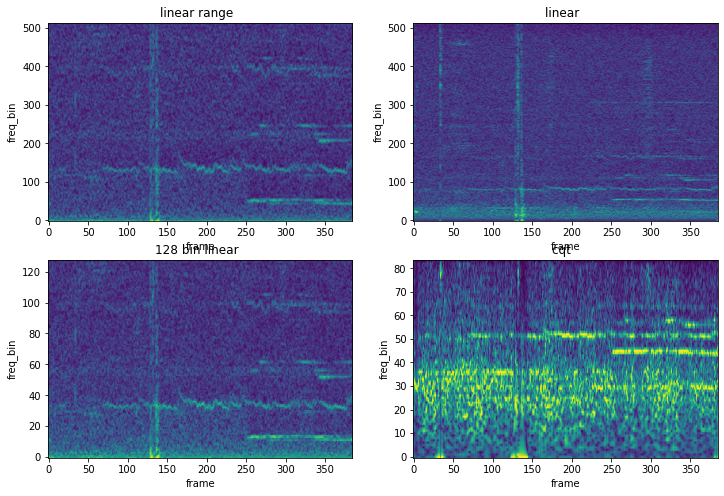

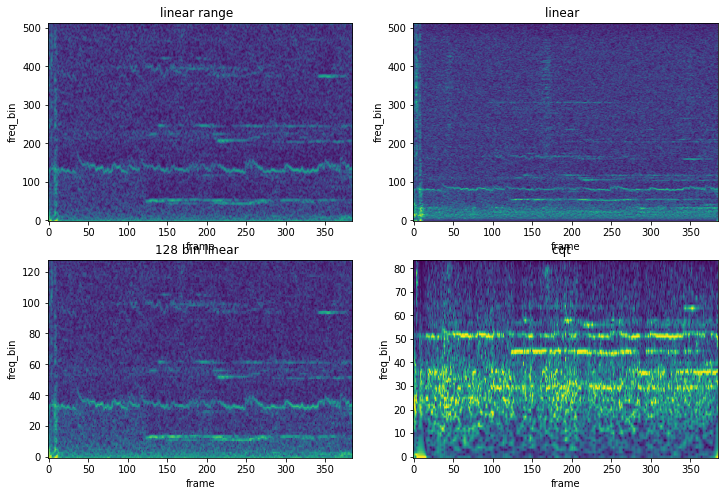

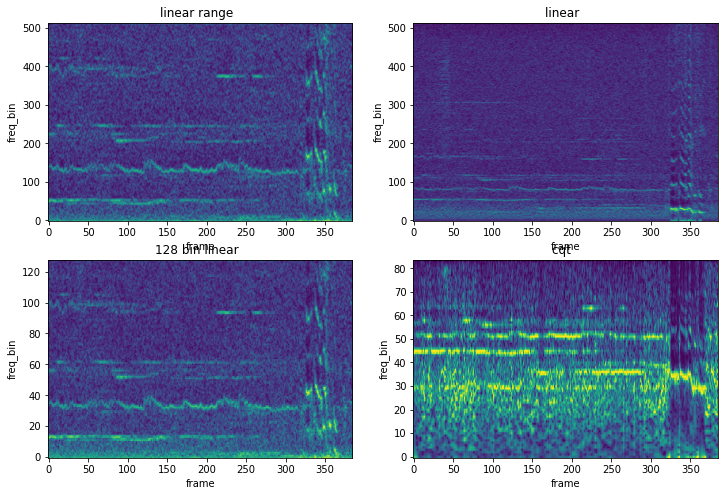

In [334]:
view_file('../data/audio/199904.wav', df_train=df_test_B,
        win_size=384, NFFT=1024, n_hop=256, step_size=384//3, min_freq=300, max_freq=1600)

In [336]:
#### 222681 is some white noise that the models often think is a mosquito
play_id(222681)

  0%|          | 0/198 [00:00<?, ?it/s]

12.288
162176 98304.0
sampling rate = 8000. Please make sure the sampling rate is correct in order toget a valid freq range
STFT kernels created, time used = 0.0173 seconds
STFT kernels created, time used = 0.0176 seconds
CQT kernels created, time used = 0.0119 seconds
sampling rate = 8000. Please make sure the sampling rate is correct in order toget a valid freq range
STFT kernels created, time used = 0.0047 seconds


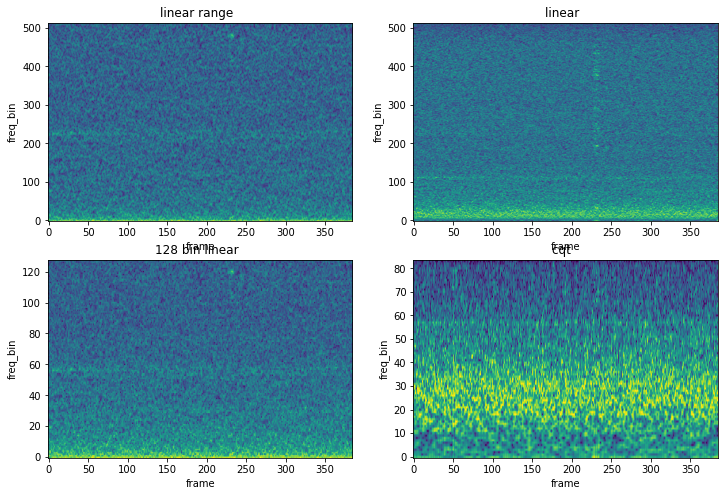

In [335]:
view_file('../data/audio/222681.wav', df_train=df_test_B,
        win_size=384, NFFT=1024, n_hop=256, step_size=384//3, min_freq=300, max_freq=1600)

In [321]:
### 221614 is labeled mosquito but it has some long gaps where there is no mosquito sound
play_id('221614')

  0%|          | 0/7934 [00:00<?, ?it/s]

15.36
sampling rate = 8000. Please make sure the sampling rate is correct in order toget a valid freq range
STFT kernels created, time used = 0.0625 seconds
STFT kernels created, time used = 0.0636 seconds
STFT kernels created, time used = 0.0095 seconds
sampling rate = 8000. Please make sure the sampling rate is correct in order toget a valid freq range
STFT kernels created, time used = 0.0096 seconds


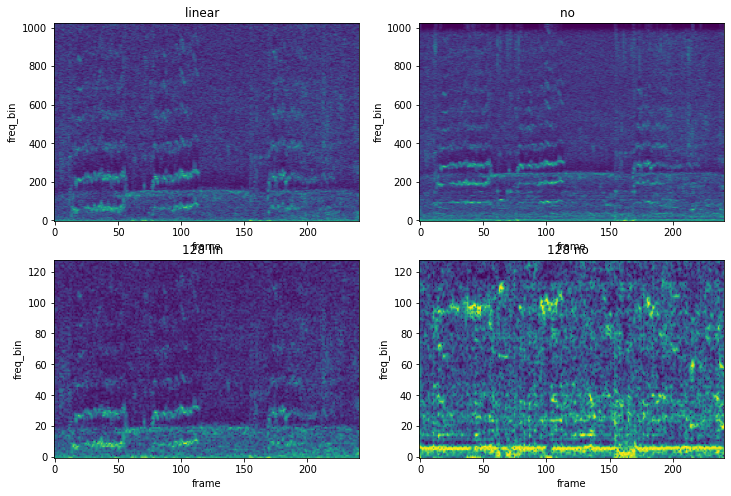

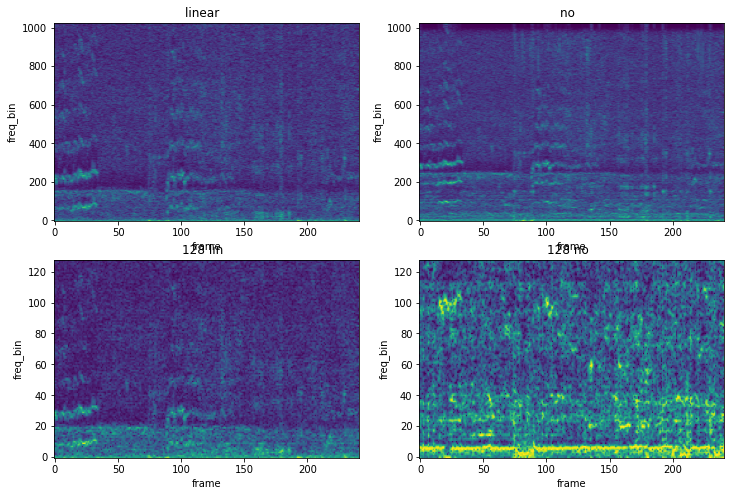

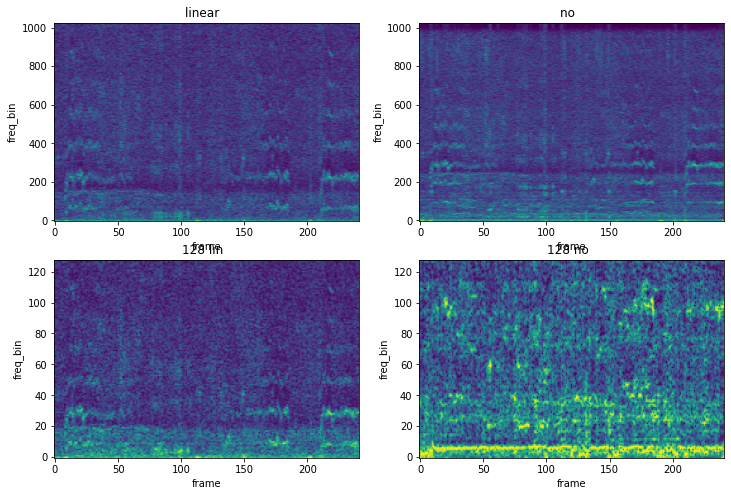

In [270]:
view_file('../data/audio/221614.wav', 
        win_size=240, NFFT=2048, n_hop=512, step_size=80, min_freq=600, max_freq=3000)

  0%|          | 0/7934 [00:00<?, ?it/s]

12.288
sampling rate = 8000. Please make sure the sampling rate is correct in order toget a valid freq range
STFT kernels created, time used = 0.0187 seconds
STFT kernels created, time used = 0.0181 seconds
STFT kernels created, time used = 0.0045 seconds
sampling rate = 8000. Please make sure the sampling rate is correct in order toget a valid freq range
STFT kernels created, time used = 0.0048 seconds


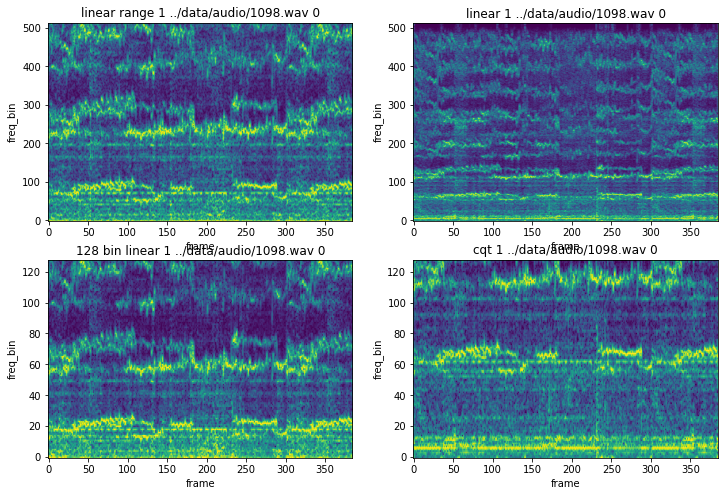

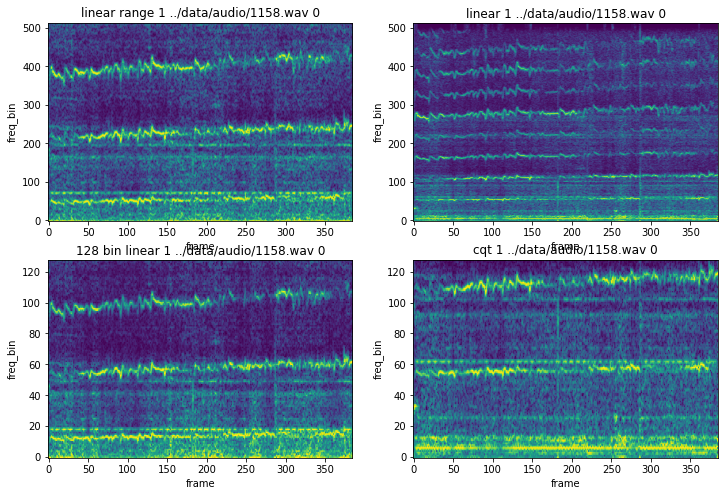

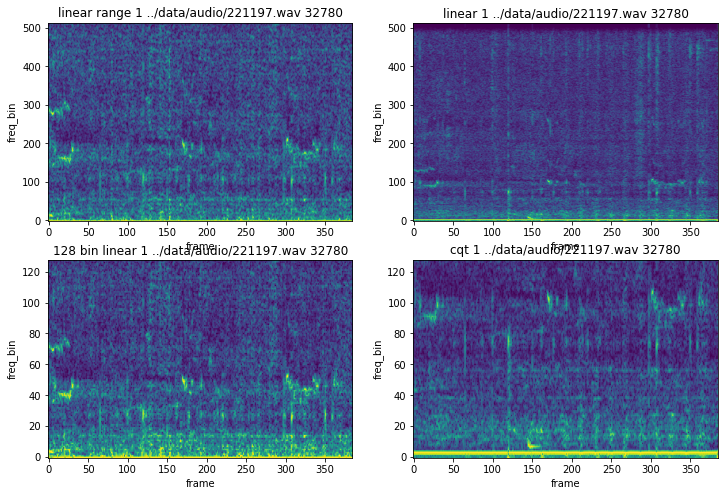

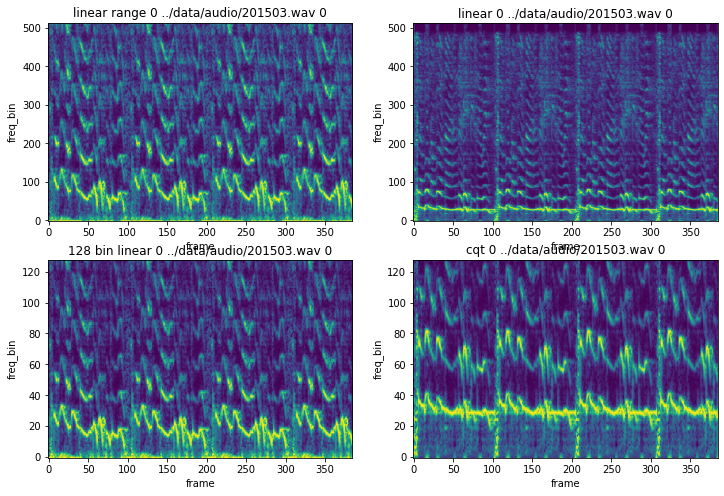

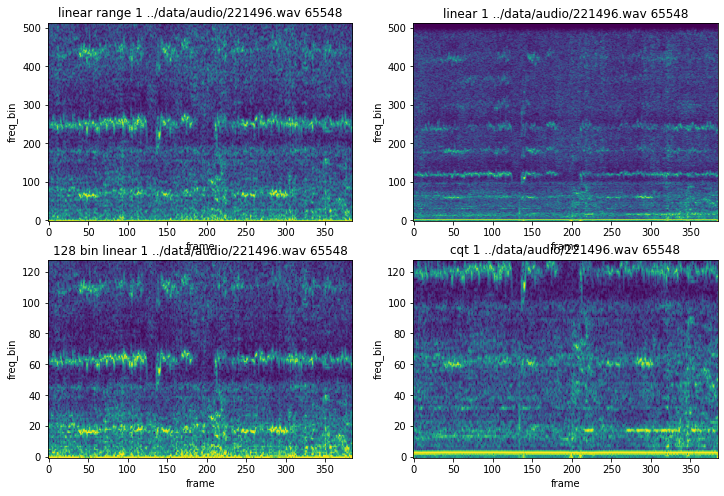

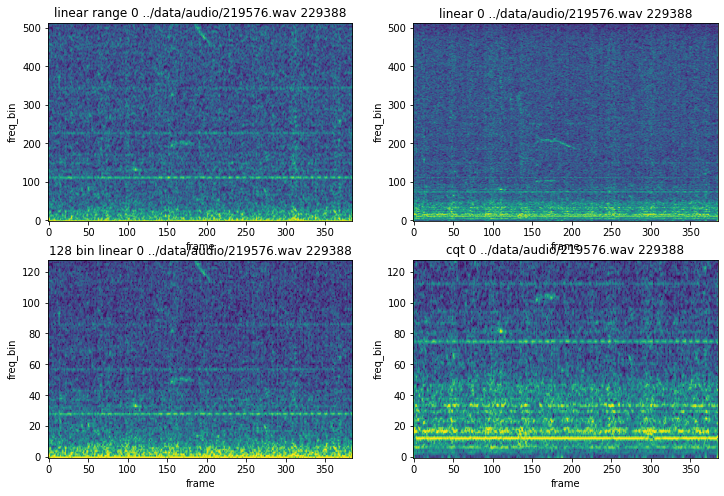

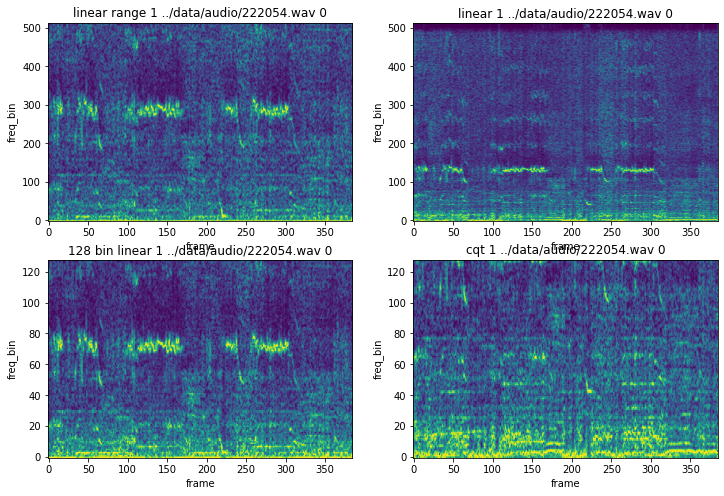

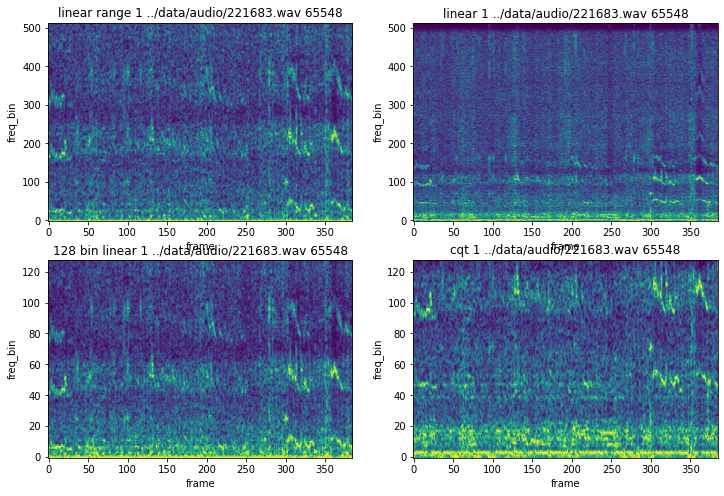

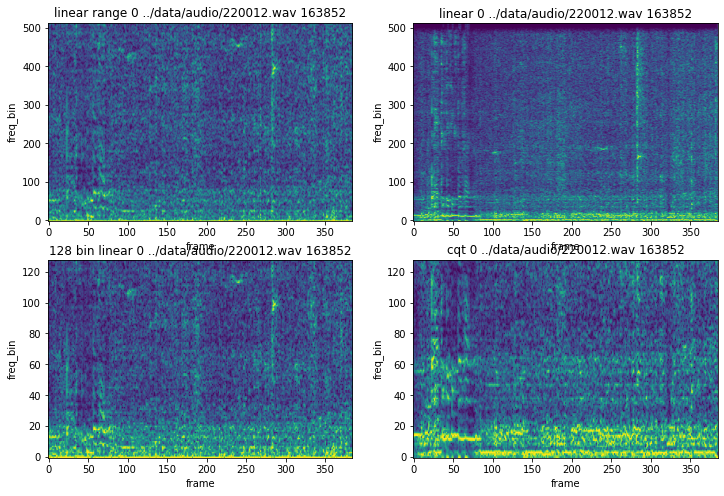

In [339]:
# here's a random sample from the training data
# the 0 or 1 in the title means background or mosquito
make_windowed_dataset(win_size=384, NFFT=1024, n_hop=1024//4, step_size=384//3, min_freq=300, max_freq=1600)

In [184]:
play_id(2651)

In [163]:
min_length, audio_df_train = get_offsets_df(df_train, short_audio=True, 
                                    win_size=224, n_hop=1024//4, step_size=80)

  0%|          | 0/7934 [00:00<?, ?it/s]

  0%|          | 0/7934 [00:00<?, ?it/s]

3.84
sampling rate = 8000. Please make sure the sampling rate is correct in order toget a valid freq range
STFT kernels created, time used = 0.0032 seconds
STFT kernels created, time used = 0.0023 seconds
STFT kernels created, time used = 0.0022 seconds
sampling rate = 8000. Please make sure the sampling rate is correct in order toget a valid freq range
STFT kernels created, time used = 0.0022 seconds


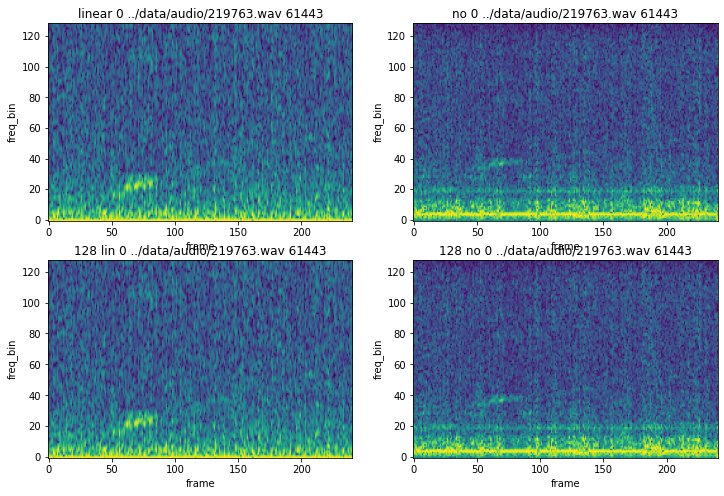

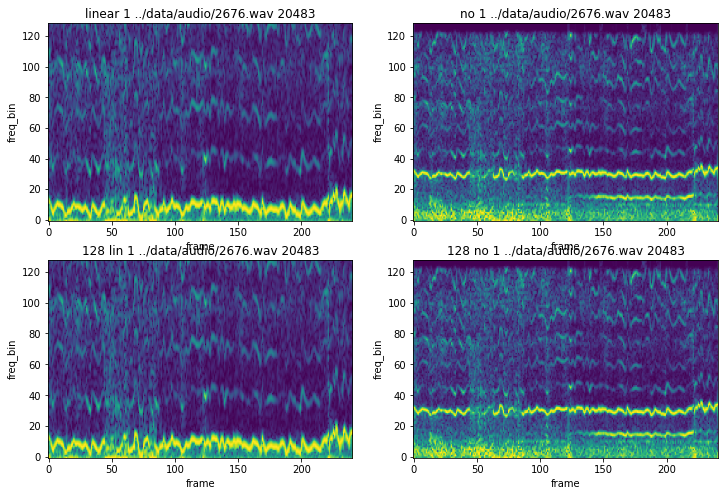

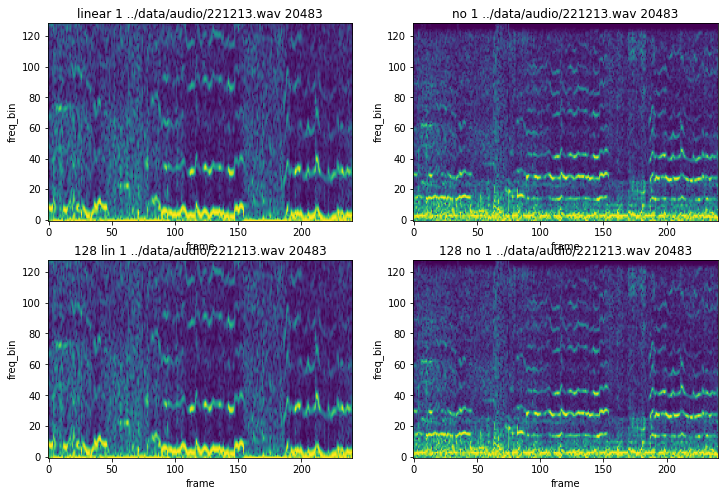

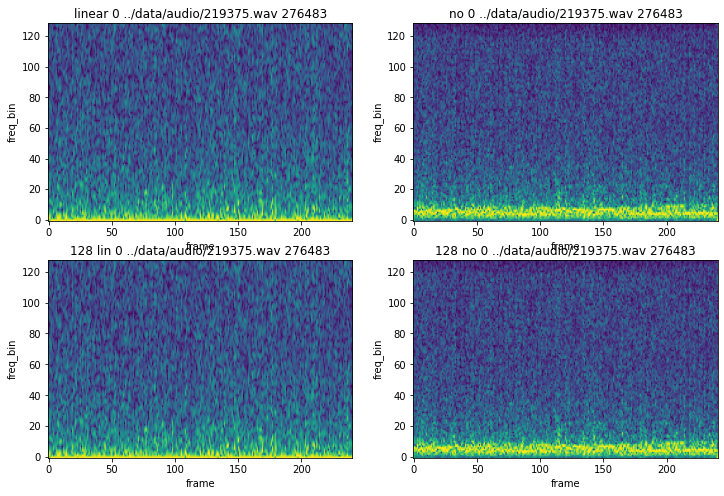

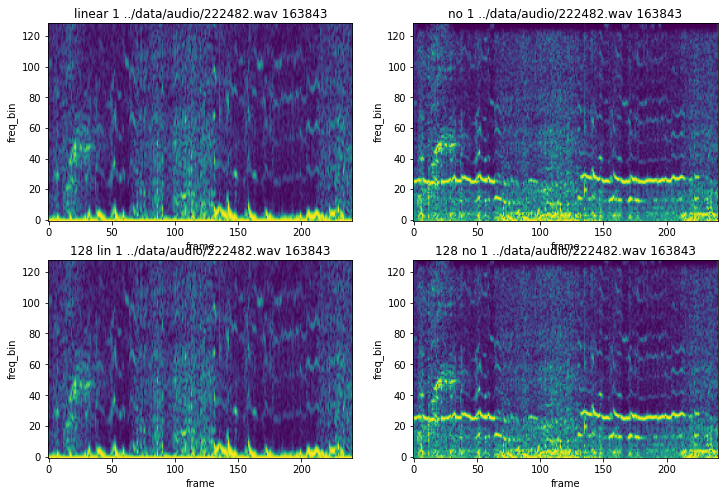

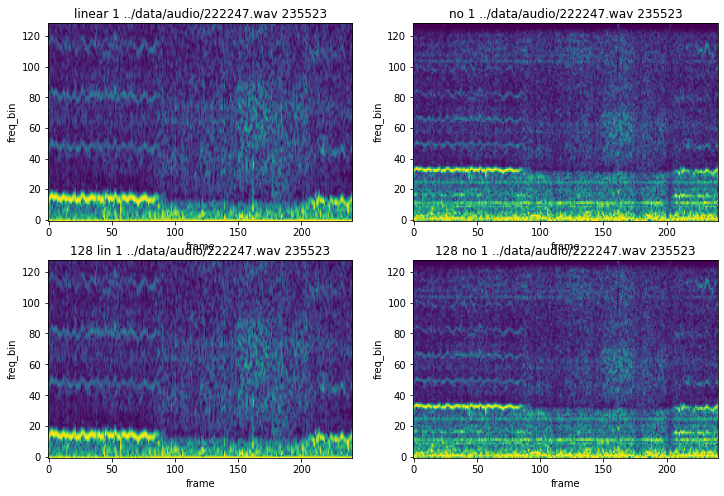

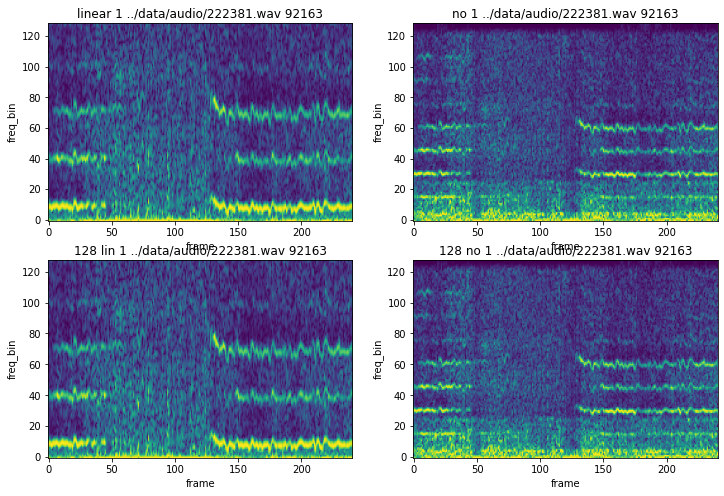

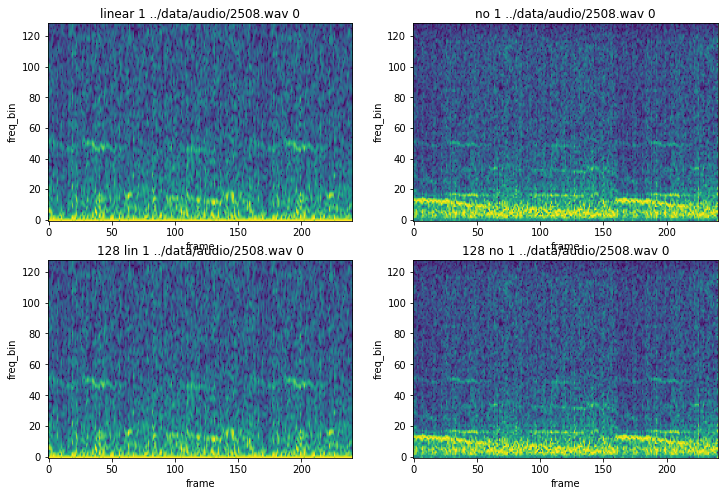

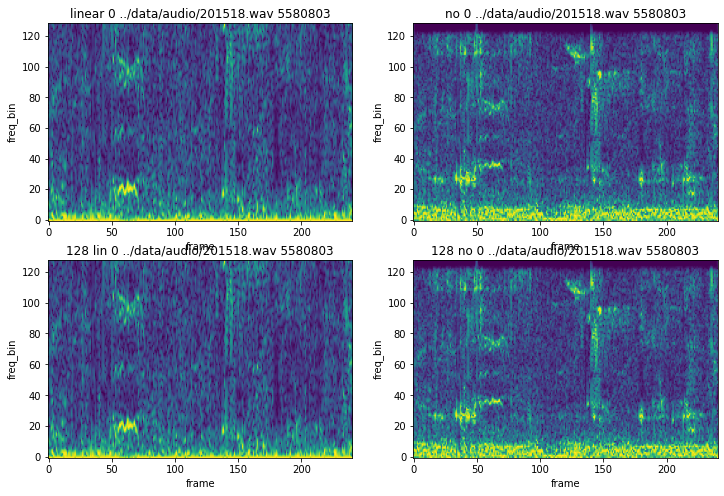

In [226]:
make_windowed_dataset(win_size=240, NFFT=256, n_hop=256//2, step_size=80, min_freq=800, max_freq=2800)

  0%|          | 0/7934 [00:00<?, ?it/s]

1.92
sampling rate = 8000. Please make sure the sampling rate is correct in order toget a valid freq range
STFT kernels created, time used = 0.0068 seconds
STFT kernels created, time used = 0.0068 seconds
STFT kernels created, time used = 0.0039 seconds
sampling rate = 8000. Please make sure the sampling rate is correct in order toget a valid freq range
STFT kernels created, time used = 0.0041 seconds


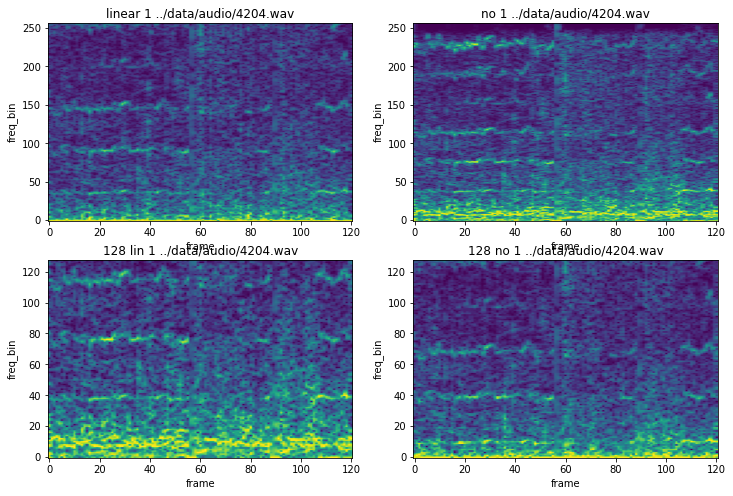

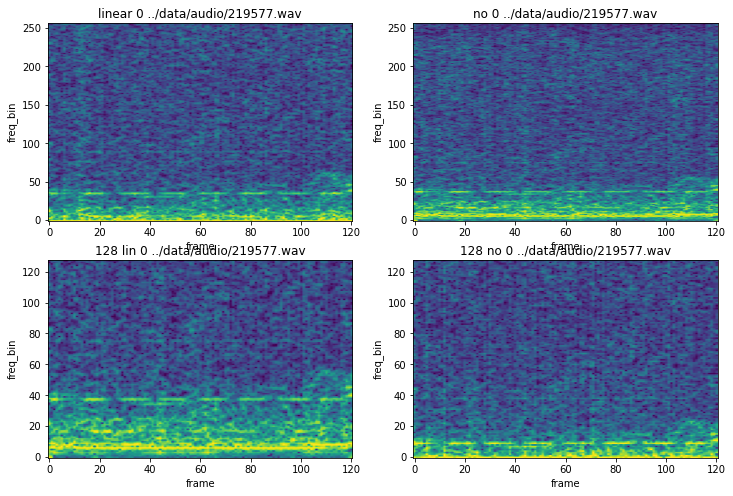

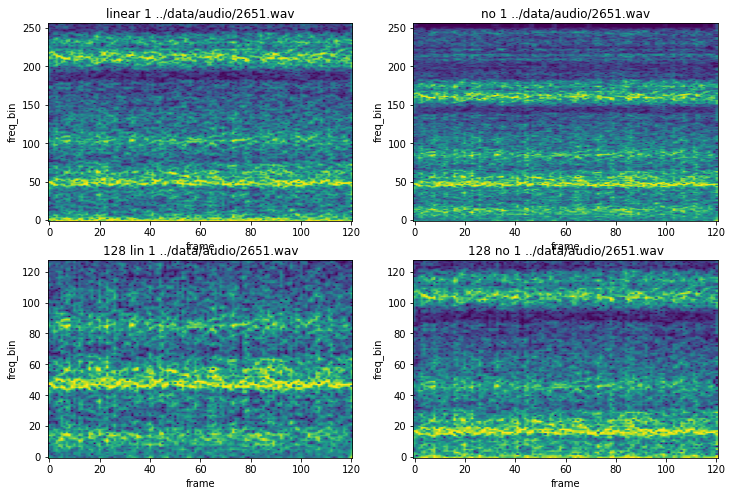

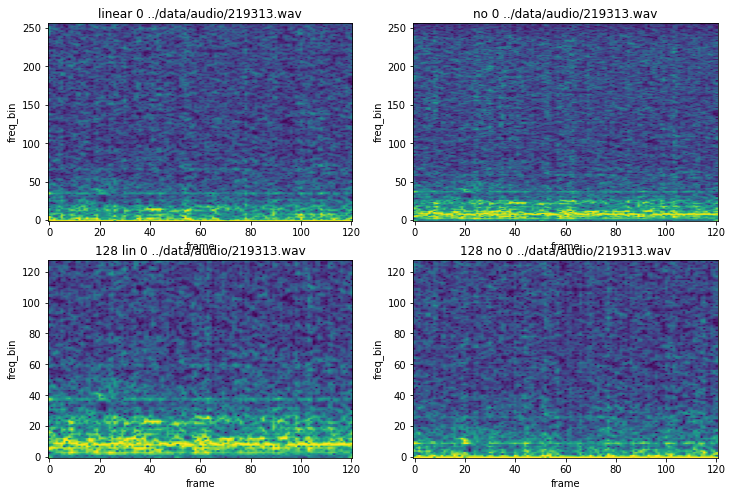

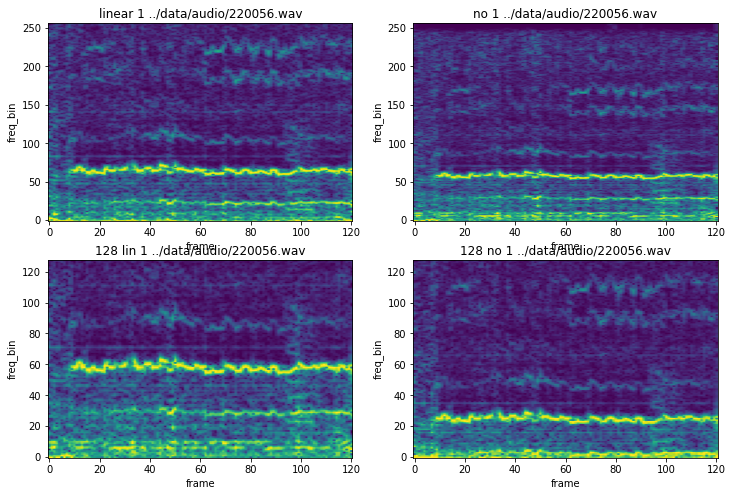

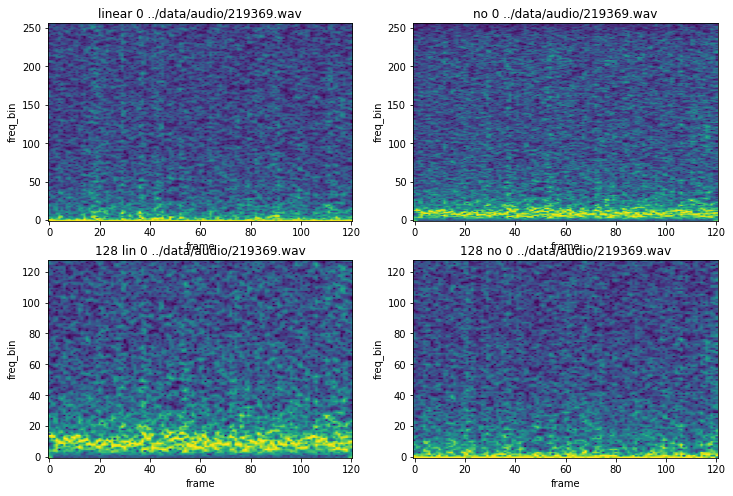

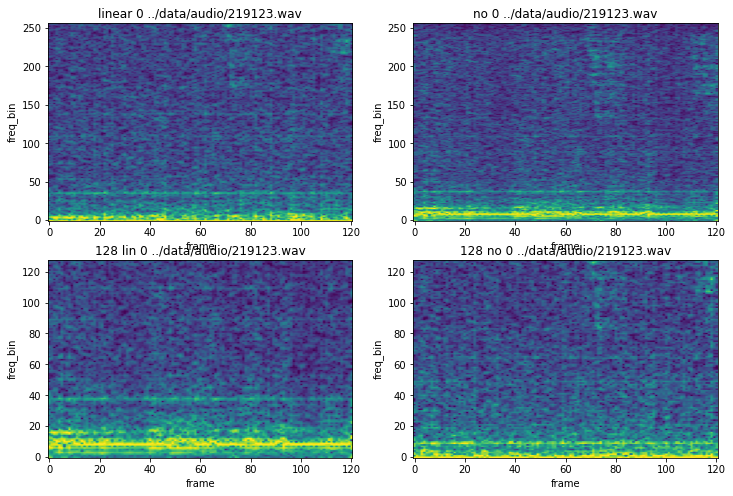

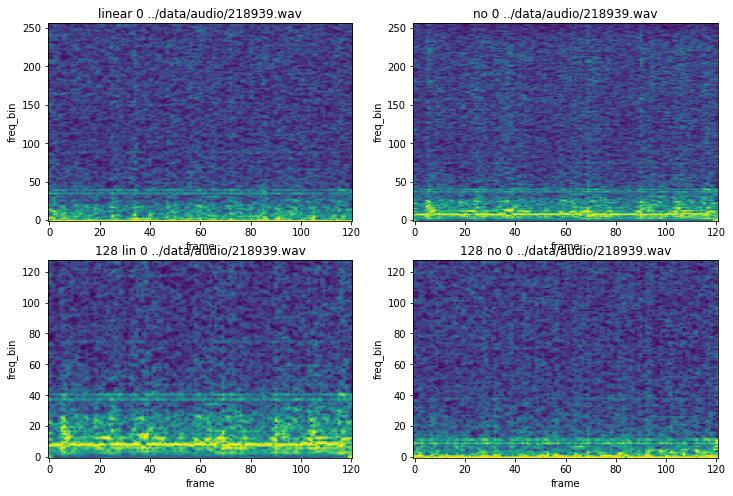

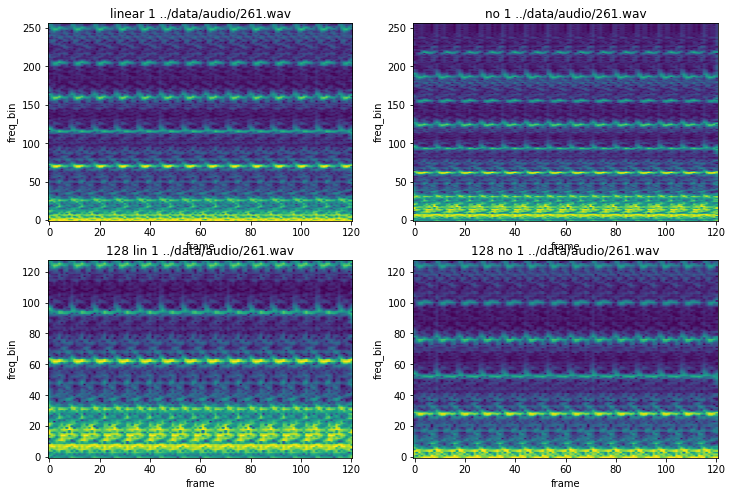

In [183]:
make_windowed_dataset(win_size=120, NFFT=512, n_hop=512//4, step_size=40, max_freq=3000)